In [1]:
import pandas as pd
import numpy as np
import math
import seaborn as sns
import matplotlib.pyplot as plt
import plotly.express as px
import missingno as msno
import plotly.graph_objects as go
from datetime import datetime
from statsmodels.stats.outliers_influence import variance_inflation_factor

from sklearn.model_selection import KFold, train_test_split,GridSearchCV
from sklearn.preprocessing import MinMaxScaler,MaxAbsScaler,RobustScaler,StandardScaler
from sklearn.feature_selection import VarianceThreshold,mutual_info_classif, f_classif
from sklearn.metrics import accuracy_score, confusion_matrix, f1_score, precision_score, recall_score
from sklearn.tree import DecisionTreeClassifier, DecisionTreeRegressor
from sklearn.metrics import roc_auc_score, mean_squared_error
from sklearn.ensemble import GradientBoostingClassifier, GradientBoostingRegressor
from sklearn.ensemble import RandomForestClassifier



from feature_engine.selection import (
    RecursiveFeatureElimination,
    DropConstantFeatures,
    DropDuplicateFeatures,
)
from sklearn.decomposition import PCA
from sklearn.svm import SVC
from operator import itemgetter


#to ignore warnings
import warnings
warnings.filterwarnings('ignore')

pd.set_option('display.max_rows', None)  # Show all rows
pd.set_option('display.max_columns', None)  # Show all columns
pd.set_option('display.width', None)  # Allow long lines

In [112]:
# Specify the path to the CSV file in the parent directory
file_path = "../Dataset/pd_speech_features/pd_speech_features.csv"

# Read the CSV file into a DataFrame
df = pd.read_csv(file_path, sep=',',skiprows=1)

In [113]:
df.head()

,id,gender,PPE,DFA,RPDE,numPulses,numPeriodsPulses,meanPeriodPulses,stdDevPeriodPulses,locPctJitter,locAbsJitter,rapJitter,ppq5Jitter,ddpJitter,locShimmer,locDbShimmer,apq3Shimmer,apq5Shimmer,apq11Shimmer,ddaShimmer,meanAutoCorrHarmonicity,meanNoiseToHarmHarmonicity,meanHarmToNoiseHarmonicity,minIntensity,maxIntensity,meanIntensity,f1,f2,f3,f4,b1,b2,b3,b4,GQ_prc5_95,GQ_std_cycle_open,GQ_std_cycle_closed,GNE_mean,GNE_std,GNE_SNR_TKEO,GNE_SNR_SEO,GNE_NSR_TKEO,GNE_NSR_SEO,VFER_mean,VFER_std,VFER_entropy,VFER_SNR_TKEO,VFER_SNR_SEO,VFER_NSR_TKEO,VFER_NSR_SEO,IMF_SNR_SEO,IMF_SNR_TKEO,IMF_SNR_entropy,IMF_NSR_SEO,IMF_NSR_TKEO,IMF_NSR_entropy,mean_Log_energy,mean_MFCC_0th_coef,mean_MFCC_1st_coef,mean_MFCC_2nd_coef,mean_MFCC_3rd_coef,mean_MFCC_4th_coef,mean_MFCC_5th_coef,mean_MFCC_6th_coef,mean_MFCC_7th_coef,mean_MFCC_8th_coef,mean_MFCC_9th_coef,mean_MFCC_10th_coef,mean_MFCC_11th_coef,mean_MFCC_12th_coef,mean_delta_log_energy,mean_0th_delta,mean_1st_delta,mean_2nd_delta,mean_3rd_delta,mean_4th_delta,mean_5th_delta,mean_6th_delta,mean_7th_delta,mean_8th_delta,mean_9th_delta,mean_10th_delta,mean_11th_delta,mean_12th_delta,mean_delta_delta_log_energy,mean_delta_delta_0th,mean_1st_delta_delta,mean_2nd_delta_delta,mean_3rd_delta_delta,mean_4th_delta_delta,mean_5th_delta_delta,mean_6th_delta_delta,mean_7th_delta_delta,mean_8th_delta_delta,mean_9th_delta_delta,mean_10th_delta_delta,mean_11th_delta_delta,mean_12th_delta_delta,std_Log_energy,std_MFCC_0th_coef,std_MFCC_1st_coef,std_MFCC_2nd_coef,std_MFCC_3rd_coef,std_MFCC_4th_coef,std_MFCC_5th_coef,std_MFCC_6th_coef,std_MFCC_7th_coef,std_MFCC_8th_coef,std_MFCC_9th_coef,std_MFCC_10th_coef,std_MFCC_11th_coef,std_MFCC_12th_coef,std_delta_log_energy,std_0th_delta,std_1st_delta,std_2nd_delta,std_3rd_delta,std_4th_delta,std_5th_delta,std_6th_delta,std_7th_delta,std_8th_delta,std_9th_delta,std_10th_delta,std_11th_delta,std_12th_delta,std_delta_delta_log_energy,std_delta_delta_0th,std_1st_delta_delta,std_2nd_delta_delta,std_3rd_delta_delta,std_4th_delta_delta,std_5th_delta_delta,std_6th_delta_delta,std_7th_delta_delta,std_8th_delta_delta,std_9th_delta_delta,std_10th_delta_delta,std_11th_delta_delta,std_12th_delta_delta,Ea,Ed_1_coef,Ed_2_coef,Ed_3_coef,Ed_4_coef,Ed_5_coef,Ed_6_coef,Ed_7_coef,Ed_8_coef,Ed_9_coef,Ed_10_coef,det_entropy_shannon_1_coef,det_entropy_shannon_2_coef,det_entropy_shannon_3_coef,det_entropy_shannon_4_coef,det_entropy_shannon_5_coef,det_entropy_shannon_6_coef,det_entropy_shannon_7_coef,det_entropy_shannon_8_coef,det_entropy_shannon_9_coef,det_entropy_shannon_10_coef,det_entropy_log_1_coef,det_entropy_log_2_coef,det_entropy_log_3_coef,det_entropy_log_4_coef,det_entropy_log_5_coef,det_entropy_log_6_coef,det_entropy_log_7_coef,det_entropy_log_8_coef,det_entropy_log_9_coef,det_entropy_log_10_coef,det_TKEO_mean_1_coef,det_TKEO_mean_2_coef,det_TKEO_mean_3_coef,det_TKEO_mean_4_coef,det_TKEO_mean_5_coef,det_TKEO_mean_6_coef,det_TKEO_mean_7_coef,det_TKEO_mean_8_coef,det_TKEO_mean_9_coef,det_TKEO_mean_10_coef,det_TKEO_std_1_coef,det_TKEO_std_2_coef,det_TKEO_std_3_coef,det_TKEO_std_4_coef,det_TKEO_std_5_coef,det_TKEO_std_6_coef,det_TKEO_std_7_coef,det_TKEO_std_8_coef,det_TKEO_std_9_coef,det_TKEO_std_10_coef,app_entropy_shannon_1_coef,app_entropy_shannon_2_coef,app_entropy_shannon_3_coef,app_entropy_shannon_4_coef,app_entropy_shannon_5_coef,app_entropy_shannon_6_coef,app_entropy_shannon_7_coef,app_entropy_shannon_8_coef,app_entropy_shannon_9_coef,app_entropy_shannon_10_coef,app_entropy_log_1_coef,app_entropy_log_2_coef,app_entropy_log_3_coef,app_entropy_log_4_coef,app_entropy_log_5_coef,app_entropy_log_6_coef,app_entropy_log_7_coef,app_entropy_log_8_coef,app_entropy_log_9_coef,app_entropy_log_10_coef,app_det_TKEO_mean_1_coef,app_det_TKEO_mean_2_coef,app_det_TKEO_mean_3_coef,app_det_TKEO_mean_4_coef,app_det_TKEO_mean_5_coef,app_det_TKEO_mean_6_coef,app_det_TKEO_mean_7_coef,app_det_TKEO_mean_8_coef,app_det_TKEO_mean_9_coef,app_det_TKEO_mean_10_coef,app_TKEO_std_1_coef,app_TKEO_std_2_coef,app_TKEO_

In [114]:
# separate dataset into train and test

X_train, X_test, y_train, y_test = train_test_split(
    df.drop(labels=['class','id'], axis=1),  # drop the target
    df['class'],  # just the target
    test_size=0.3,
    random_state=0)

X_train.shape, X_test.shape

((529, 753), (227, 753))

In [115]:
print(X_train.shape)
print(X_test.shape)

(529, 753)
(227, 753)


# Using VarianceThreshold from Scikit-learn

In [116]:
sel = VarianceThreshold(threshold=0)

sel.fit(X_train)  # fit finds the features with zero variance

VarianceThreshold(threshold=0)

In [117]:
# get_support is a boolean vector that indicates which features are retained
# if we sum over get_support, we get the number of features that are not constant

# (go ahead and print the result of sel.get_support() to understand its output)

sum(sel.get_support())

753

In [118]:
# now let's print the number of constant feautures
# (see how we use ~ to exclude non-constant features)

constant = X_train.columns[~sel.get_support()]

len(constant)

0

# Remove quasi-constant features

# Using the VarianceThreshold from sklearn

In [119]:
# remove constant and quasi-constant features first:
# we can remove the 2 types of features together with this code
# (we used it in our previous notebook)

# create an empty list
quasi_constant_feat = []

# iterate over every feature
for feature in X_train.columns:

    # find the predominant value, that is the value that is shared
    # by most observations
    predominant = (X_train[feature].value_counts() / float(
        len(X_train))).sort_values(ascending=False).values[0]

    # evaluate predominant feature: do more than 99% of the observations
    # show 1 value?
    if predominant > 0.998:
        quasi_constant_feat.append(feature)

len(quasi_constant_feat)

0

# Remove duplicated features

In [120]:
# check for duplicated features in the training set:

# create an empty dictionary, where we will store 
# the groups of duplicates
duplicated_feat_pairs = {}

# create an empty list to collect features
# that were found to be duplicated
_duplicated_feat = []


# iterate over every feature in our dataset:
for i in range(0, len(X_train.columns)):
    
    # this bit helps me understand where the loop is at:
    if i % 10 == 0:  
        print(i)
    
    # choose 1 feature:
    feat_1 = X_train.columns[i]
    
    # check if this feature has already been identified
    # as a duplicate of another one. If it was, it should be stored in
    # our _duplicated_feat list.
    
    # If this feature was already identified as a duplicate, we skip it, if
    # it has not yet been identified as a duplicate, then we proceed:
    if feat_1 not in _duplicated_feat:
    
        # create an empty list as an entry for this feature in the dictionary:
        duplicated_feat_pairs[feat_1] = []

        # now, iterate over the remaining features of the dataset:
        for feat_2 in X_train.columns[i + 1:]:

            # check if this second feature is identical to the first one
            if X_train[feat_1].equals(X_train[feat_2]):

                # if it is identical, append it to the list in the dictionary
                duplicated_feat_pairs[feat_1].append(feat_2)
                
                # and append it to our monitor list for duplicated variables
                _duplicated_feat.append(feat_2)
                
                # done!

0
10
20
30
40
50
60
70
80
90
100
110
120
130
140
150
160
170
180
190
200
210
220
230
240
250
260
270
280
290
300
310
320
330
340
350
360
370
380
390
400
410
420
430
440
450
460
470
480
490
500
510
520
530
540
550
560
570
580
590
600
610
620
630
640
650
660
670
680
690
700
710
720
730
740
750


In [121]:
# let's explore our list of duplicated features
len(_duplicated_feat)

0

# Remove constant features

In [122]:
sel = DropConstantFeatures(tol=1, variables=None, missing_values='raise')

sel.fit(X_train)

DropConstantFeatures()

In [123]:
# list of constant features

sel.features_to_drop_

[]

# Remove quasi-constant features

In [124]:
sel = DropConstantFeatures(tol=0.998, variables=None, missing_values='raise')

sel.fit(X_train)

DropConstantFeatures(tol=0.998)

In [125]:
# number of quasi-constant features

len(sel.features_to_drop_)

0

# Remove duplicated features

In [126]:
# set up the selector
sel = DropDuplicateFeatures(variables=None, missing_values='raise')

# find the duplicate features, this might take a while
sel.fit(X_train)

DropDuplicateFeatures(missing_values='raise')

In [127]:
# these are the pairs of duplicated features
# each set are duplicates

sel.duplicated_feature_sets_

[]

# Correlation heatmap

<AxesSubplot:>

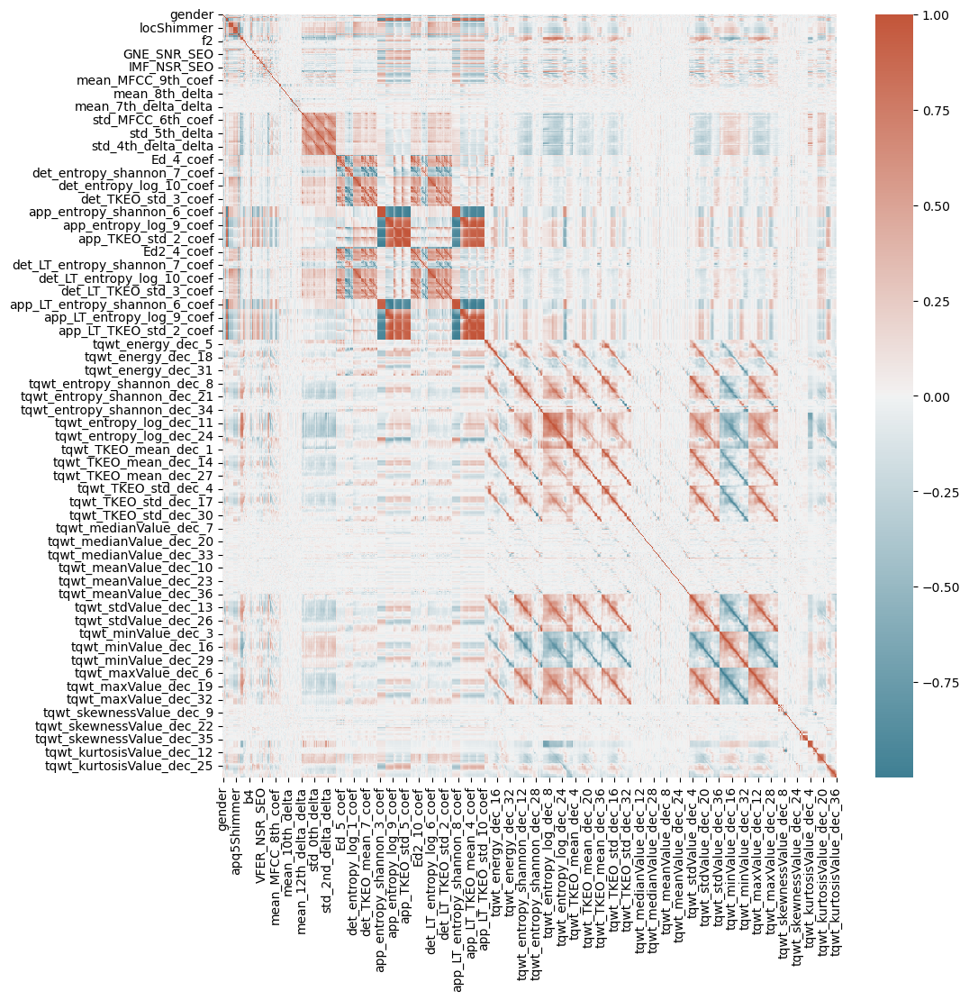

In [128]:
# visualise correlated features:

# I will build a correlation matrix, which examines the 
# correlation of all features (that is, for all possible feature combinations)
# and then visualise the correlation matrix using a heatmap

# the default correlation method of pandas.corr is pearson
# I include it anyways for the demo
corrmat = X_train.corr(method='pearson')

# we can make a heatmap with the package seaborn
# and customise the colours of searborn's heatmap
cmap = sns.diverging_palette(220, 20, as_cmap=True)

# some more parameters for the figure
fig, ax = plt.subplots()
fig.set_size_inches(11,11)

# and now plot the correlation matrix
sns.heatmap(corrmat, cmap=cmap)

# Correlation scatterplots

In [129]:
# Looking at the heatmap, we see that app_entropy_log_9_coef is highly correlated 
# with others in the dataset

# with this code we can get the other variable names
# and also print the correlation coefficient between app_entropy_log_9_coef and 
# these variables:

c = 0

# iterate over each correlation value for var_5:
for i in corrmat.loc['app_entropy_log_9_coef']:
    
    # if highly correlated
    if i>0.8:
        
        # print the variable name and the correlation coefficient
        print(corrmat.columns[c], i)
        
    c = c +1

numPulses 0.8458153504708559
numPeriodsPulses 0.8471000621048642
app_entropy_log_3_coef 0.8014450184225094
app_entropy_log_4_coef 0.8751024928720398
app_entropy_log_5_coef 0.9462056323966159
app_entropy_log_6_coef 0.9823637632836539
app_entropy_log_7_coef 0.9864060534329081
app_entropy_log_8_coef 0.9999995765373256
app_entropy_log_9_coef 1.0
app_entropy_log_10_coef 0.9999950981206315
app_det_TKEO_mean_4_coef 0.876435865717552
app_det_TKEO_mean_5_coef 0.8935888468629567
app_det_TKEO_mean_6_coef 0.9024508224561169
app_det_TKEO_mean_7_coef 0.9081292394808634
app_det_TKEO_mean_8_coef 0.9148728446857418
app_det_TKEO_mean_9_coef 0.915459403771196
app_det_TKEO_mean_10_coef 0.9189220190136391
app_TKEO_std_4_coef 0.8589376856799446
app_TKEO_std_5_coef 0.878708906822422
app_TKEO_std_6_coef 0.8858428257444201
app_TKEO_std_7_coef 0.8971998564491247
app_TKEO_std_8_coef 0.9064613308966906
app_TKEO_std_9_coef 0.9160792443507042
app_TKEO_std_10_coef 0.9185989967578582
app_LT_entropy_log_6_coef 0.89452

# Remove correlated

In [130]:
# with the following function we can select highly correlated features
# it will remove the first feature that is correlated with anything else
# without any further insight.

def correlation(dataset, threshold):
    
    # create a set where I will store the names of correlated columns
    col_corr = set()
    
    # create the correlation matrix
    corr_matrix = dataset.corr()
    
    # for each feature in the dataset (columns of the correlation matrix)
    for i in range(len(corr_matrix.columns)):
        
        # check with other features
        for j in range(i):
            
            # if the correlation is higher than a certain threshold
            if abs(corr_matrix.iloc[i, j]) > threshold: # we are interested in absolute coeff value
                
                # print correlation, and variables examined
                # keep in mind that the columns and rows of the dataframe are identical
                # so we can identify the features being examned by looking for i,j
                # in the column names
                print(abs(corr_matrix.iloc[i, j]), corr_matrix.columns[i], corr_matrix.columns[j])
                
                # get the name of the correlated feature
                colname = corr_matrix.columns[j]
                
                # and add it to our correlated set
                col_corr.add(colname)
                
    return col_corr

In [131]:
X_train.shape

(529, 753)

In [132]:
corr_features = correlation(X_train, 0.8)
len(set(corr_features))

0.999895645879297 numPeriodsPulses numPulses
0.9008385529187313 meanPeriodPulses numPulses
0.9002038494881142 meanPeriodPulses numPeriodsPulses
0.9675311556642671 locAbsJitter locPctJitter
0.9604652696048572 rapJitter locPctJitter
0.9516833325135459 rapJitter locAbsJitter
0.9628511271515479 ppq5Jitter locPctJitter
0.9472313479120772 ppq5Jitter locAbsJitter
0.9738637565388939 ppq5Jitter rapJitter
0.9604918945662954 ddpJitter locPctJitter
0.9517198939980195 ddpJitter locAbsJitter
0.9999965536400339 ddpJitter rapJitter
0.9738756656673944 ddpJitter ppq5Jitter
0.9956203143501046 locDbShimmer locShimmer
0.9802536866115182 apq3Shimmer locShimmer
0.9717312649584026 apq3Shimmer locDbShimmer
0.9762334683691635 apq5Shimmer locShimmer
0.9683882636393041 apq5Shimmer locDbShimmer
0.9569399790299391 apq5Shimmer apq3Shimmer
0.8730087637145723 apq11Shimmer locShimmer
0.8724696743718325 apq11Shimmer locDbShimmer
0.8222886342812946 apq11Shimmer apq3Shimmer
0.9031198838432849 apq11Shimmer apq5Shimmer
0.98

0.817967436658309 det_LT_entropy_shannon_6_coef det_entropy_shannon_6_coef
0.8085232247545765 det_LT_entropy_shannon_6_coef det_TKEO_std_6_coef
0.88104847231058 det_LT_entropy_shannon_6_coef Ed2_6_coef
0.9374381670013455 det_LT_entropy_shannon_7_coef det_entropy_shannon_7_coef
0.9016220821469623 det_LT_entropy_shannon_7_coef det_TKEO_mean_7_coef
0.9067108260556049 det_LT_entropy_shannon_7_coef det_TKEO_std_7_coef
0.8847122272685559 det_LT_entropy_shannon_7_coef Ed2_7_coef
0.9718529254070618 det_LT_entropy_shannon_8_coef Ed2_8_coef
0.9061971933601591 det_LT_entropy_shannon_9_coef Ed2_9_coef
0.9745581643950075 det_LT_entropy_shannon_10_coef Ed2_10_coef
0.9333474549687656 det_LT_entropy_log_1_coef det_entropy_log_1_coef
0.8968144440709179 det_LT_entropy_log_1_coef det_entropy_log_2_coef
0.8152730230133174 det_LT_entropy_log_1_coef det_entropy_log_3_coef
0.8811076049455125 det_LT_entropy_log_2_coef det_entropy_log_1_coef
0.9376103886177197 det_LT_entropy_log_2_coef det_entropy_log_2_coef
0

0.9240436810195133 app_LT_entropy_shannon_9_coef app_entropy_shannon_4_coef
0.9285857239427108 app_LT_entropy_shannon_9_coef app_entropy_shannon_5_coef
0.9312486993847321 app_LT_entropy_shannon_9_coef app_entropy_shannon_6_coef
0.9320803658221046 app_LT_entropy_shannon_9_coef app_entropy_shannon_7_coef
0.9334869250227701 app_LT_entropy_shannon_9_coef app_entropy_shannon_8_coef
0.9338096673303563 app_LT_entropy_shannon_9_coef app_entropy_shannon_9_coef
0.9341796588987383 app_LT_entropy_shannon_9_coef app_entropy_shannon_10_coef
0.8017721301572596 app_LT_entropy_shannon_9_coef app_entropy_log_3_coef
0.8743816295471312 app_LT_entropy_shannon_9_coef app_entropy_log_4_coef
0.9443729267827375 app_LT_entropy_shannon_9_coef app_entropy_log_5_coef
0.9797695830431676 app_LT_entropy_shannon_9_coef app_entropy_log_6_coef
0.9835006383642079 app_LT_entropy_shannon_9_coef app_entropy_log_7_coef
0.9964928897697076 app_LT_entropy_shannon_9_coef app_entropy_log_8_coef
0.9964921701261723 app_LT_entropy_s

0.8216972903836325 tqwt_energy_dec_4 tqwt_energy_dec_2
0.8760610304884955 tqwt_energy_dec_4 tqwt_energy_dec_3
0.8927779690887317 tqwt_energy_dec_6 tqwt_energy_dec_5
0.8447624558756831 tqwt_energy_dec_7 tqwt_energy_dec_6
0.9008952326116944 tqwt_energy_dec_8 tqwt_energy_dec_7
0.8994648137673514 tqwt_energy_dec_10 tqwt_energy_dec_9
0.8710706962724669 tqwt_energy_dec_13 tqwt_energy_dec_12
0.8144112738960175 tqwt_energy_dec_14 tqwt_energy_dec_13
0.8286181926875436 tqwt_energy_dec_15 tqwt_energy_dec_14
0.8101406826834135 tqwt_energy_dec_16 tqwt_energy_dec_15
0.9103081937792701 tqwt_energy_dec_33 tqwt_energy_dec_32
0.8721253352890245 tqwt_energy_dec_34 tqwt_energy_dec_33
0.8750829665074086 tqwt_energy_dec_36 tqwt_energy_dec_35
0.8496387702836943 tqwt_entropy_shannon_dec_2 tqwt_entropy_shannon_dec_1
0.9451744027692318 tqwt_entropy_shannon_dec_3 tqwt_entropy_shannon_dec_2
0.8322152738768068 tqwt_entropy_shannon_dec_4 tqwt_entropy_shannon_dec_3
0.8548334098479227 tqwt_entropy_shannon_dec_5 tqwt_

0.864060837131124 tqwt_TKEO_mean_dec_9 tqwt_entropy_shannon_dec_8
0.9846504305128381 tqwt_TKEO_mean_dec_9 tqwt_entropy_shannon_dec_9
0.9797727965745001 tqwt_TKEO_mean_dec_10 tqwt_entropy_shannon_dec_10
0.8132235072714263 tqwt_TKEO_mean_dec_11 tqwt_entropy_shannon_dec_10
0.9420776738495237 tqwt_TKEO_mean_dec_11 tqwt_entropy_shannon_dec_11
0.8071264063462603 tqwt_TKEO_mean_dec_12 tqwt_energy_dec_12
0.9594032776318333 tqwt_TKEO_mean_dec_12 tqwt_entropy_shannon_dec_12
0.9358949452758513 tqwt_TKEO_mean_dec_13 tqwt_entropy_shannon_dec_12
0.9297175345985655 tqwt_TKEO_mean_dec_13 tqwt_entropy_shannon_dec_13
0.8528417043146874 tqwt_TKEO_mean_dec_13 tqwt_TKEO_mean_dec_12
0.8951376239404379 tqwt_TKEO_mean_dec_14 tqwt_entropy_shannon_dec_13
0.9374643764335063 tqwt_TKEO_mean_dec_14 tqwt_entropy_shannon_dec_14
0.8531132981884262 tqwt_TKEO_mean_dec_15 tqwt_entropy_shannon_dec_14
0.9146482390168492 tqwt_TKEO_mean_dec_15 tqwt_entropy_shannon_dec_15
0.80678993352274 tqwt_TKEO_mean_dec_16 tqwt_energy_dec

0.8321104526535105 tqwt_meanValue_dec_33 tqwt_entropy_shannon_dec_32
0.8319925271334858 tqwt_meanValue_dec_33 tqwt_entropy_shannon_dec_33
0.866517991580952 tqwt_meanValue_dec_33 tqwt_TKEO_mean_dec_32
0.8612417727776223 tqwt_meanValue_dec_33 tqwt_TKEO_mean_dec_33
0.8636297722539937 tqwt_meanValue_dec_33 tqwt_TKEO_std_dec_32
0.8705083811128895 tqwt_meanValue_dec_33 tqwt_TKEO_std_dec_33
0.877415584041629 tqwt_meanValue_dec_36 tqwt_medianValue_dec_36
0.9503345534171205 tqwt_stdValue_dec_1 tqwt_entropy_shannon_dec_1
0.810502697310214 tqwt_stdValue_dec_1 tqwt_entropy_shannon_dec_2
0.9129216895957888 tqwt_stdValue_dec_1 tqwt_TKEO_mean_dec_1
0.8090678535827456 tqwt_stdValue_dec_2 tqwt_entropy_shannon_dec_1
0.941256639365153 tqwt_stdValue_dec_2 tqwt_entropy_shannon_dec_2
0.9047978433236327 tqwt_stdValue_dec_2 tqwt_entropy_shannon_dec_3
0.904201103828529 tqwt_stdValue_dec_2 tqwt_TKEO_mean_dec_2
0.866453806652782 tqwt_stdValue_dec_2 tqwt_TKEO_mean_dec_3
0.8451603177820086 tqwt_stdValue_dec_2 tqwt

0.8325730837924057 tqwt_stdValue_dec_19 tqwt_entropy_log_dec_19
0.8074339890339897 tqwt_stdValue_dec_19 tqwt_TKEO_mean_dec_18
0.9021361932934417 tqwt_stdValue_dec_19 tqwt_TKEO_mean_dec_19
0.8430594477780174 tqwt_stdValue_dec_19 tqwt_TKEO_std_dec_18
0.9138395211152675 tqwt_stdValue_dec_19 tqwt_TKEO_std_dec_19
0.8835868274192267 tqwt_stdValue_dec_19 tqwt_stdValue_dec_18
0.9689568536426993 tqwt_stdValue_dec_20 tqwt_entropy_shannon_dec_20
0.8413508300233605 tqwt_stdValue_dec_20 tqwt_entropy_log_dec_20
0.9146164773542642 tqwt_stdValue_dec_20 tqwt_TKEO_mean_dec_20
0.868244673285113 tqwt_stdValue_dec_20 tqwt_TKEO_std_dec_20
0.9074107711526705 tqwt_stdValue_dec_21 tqwt_entropy_shannon_dec_21
0.8278650183613846 tqwt_stdValue_dec_21 tqwt_entropy_log_dec_21
0.8873624910616827 tqwt_stdValue_dec_21 tqwt_TKEO_mean_dec_21
0.8487025748798387 tqwt_stdValue_dec_21 tqwt_TKEO_std_dec_21
0.9105865204691479 tqwt_stdValue_dec_22 tqwt_entropy_shannon_dec_22
0.8148902560500383 tqwt_stdValue_dec_22 tqwt_entropy

0.9452665120288721 tqwt_maxValue_dec_2 tqwt_minValue_dec_2
0.9258273960988513 tqwt_maxValue_dec_2 tqwt_minValue_dec_3
0.8103771714640268 tqwt_maxValue_dec_2 tqwt_minValue_dec_4
0.8403672148232153 tqwt_maxValue_dec_2 tqwt_maxValue_dec_1
0.8001754594726976 tqwt_maxValue_dec_3 tqwt_stdValue_dec_3
0.9307724328626579 tqwt_maxValue_dec_3 tqwt_minValue_dec_2
0.9863504155389182 tqwt_maxValue_dec_3 tqwt_minValue_dec_3
0.9070639418518134 tqwt_maxValue_dec_3 tqwt_minValue_dec_4
0.9305452755299358 tqwt_maxValue_dec_3 tqwt_maxValue_dec_2
0.8465005339293709 tqwt_maxValue_dec_4 tqwt_stdValue_dec_4
0.8146223505248484 tqwt_maxValue_dec_4 tqwt_minValue_dec_2
0.9093110278853844 tqwt_maxValue_dec_4 tqwt_minValue_dec_3
0.9824100372274898 tqwt_maxValue_dec_4 tqwt_minValue_dec_4
0.9193630854549758 tqwt_maxValue_dec_4 tqwt_minValue_dec_5
0.8241639981920987 tqwt_maxValue_dec_4 tqwt_maxValue_dec_2
0.906300227795408 tqwt_maxValue_dec_4 tqwt_maxValue_dec_3
0.8156994678498236 tqwt_maxValue_dec_5 tqwt_entropy_shann

0.9907617974367808 tqwt_maxValue_dec_27 tqwt_minValue_dec_27
0.8106179655812646 tqwt_maxValue_dec_27 tqwt_minValue_dec_28
0.8742163652945998 tqwt_maxValue_dec_28 tqwt_TKEO_mean_dec_28
0.8738054006178011 tqwt_maxValue_dec_28 tqwt_TKEO_std_dec_28
0.968960241093824 tqwt_maxValue_dec_28 tqwt_stdValue_dec_28
0.8042529752989185 tqwt_maxValue_dec_28 tqwt_minValue_dec_27
0.9874337691047703 tqwt_maxValue_dec_28 tqwt_minValue_dec_28
0.8189533288428331 tqwt_maxValue_dec_28 tqwt_minValue_dec_29
0.8083005463057287 tqwt_maxValue_dec_28 tqwt_maxValue_dec_27
0.8318000665267518 tqwt_maxValue_dec_29 tqwt_energy_dec_29
0.8059724080316055 tqwt_maxValue_dec_29 tqwt_TKEO_mean_dec_28
0.8048898355992399 tqwt_maxValue_dec_29 tqwt_TKEO_mean_dec_29
0.8053236477527141 tqwt_maxValue_dec_29 tqwt_TKEO_std_dec_28
0.8681140842788817 tqwt_maxValue_dec_29 tqwt_TKEO_std_dec_29
0.947702106720917 tqwt_maxValue_dec_29 tqwt_stdValue_dec_29
0.8544904772190051 tqwt_maxValue_dec_29 tqwt_stdValue_dec_30
0.8125502218168145 tqwt_m

504

In [133]:
corr_features

{'Ea',
 'Ea2',
 'Ed2_10_coef',
 'Ed2_1_coef',
 'Ed2_2_coef',
 'Ed2_3_coef',
 'Ed2_4_coef',
 'Ed2_5_coef',
 'Ed2_6_coef',
 'Ed2_7_coef',
 'Ed2_8_coef',
 'Ed2_9_coef',
 'Ed_10_coef',
 'Ed_1_coef',
 'Ed_2_coef',
 'Ed_3_coef',
 'Ed_4_coef',
 'Ed_5_coef',
 'Ed_6_coef',
 'Ed_7_coef',
 'Ed_8_coef',
 'Ed_9_coef',
 'GNE_SNR_TKEO',
 'IMF_NSR_SEO',
 'IMF_SNR_SEO',
 'VFER_mean',
 'app_LT_TKEO_mean_10_coef',
 'app_LT_TKEO_mean_1_coef',
 'app_LT_TKEO_mean_2_coef',
 'app_LT_TKEO_mean_3_coef',
 'app_LT_TKEO_mean_4_coef',
 'app_LT_TKEO_mean_5_coef',
 'app_LT_TKEO_mean_6_coef',
 'app_LT_TKEO_mean_7_coef',
 'app_LT_TKEO_mean_8_coef',
 'app_LT_TKEO_mean_9_coef',
 'app_LT_TKEO_std_1_coef',
 'app_LT_TKEO_std_2_coef',
 'app_LT_TKEO_std_3_coef',
 'app_LT_TKEO_std_4_coef',
 'app_LT_TKEO_std_5_coef',
 'app_LT_TKEO_std_6_coef',
 'app_LT_TKEO_std_7_coef',
 'app_LT_TKEO_std_8_coef',
 'app_LT_TKEO_std_9_coef',
 'app_LT_entropy_log_10_coef',
 'app_LT_entropy_log_1_coef',
 'app_LT_entropy_log_2_coef',
 'app_LT_entrop

In [134]:
X_train.drop(labels=corr_features, axis=1, inplace=True)
X_test.drop(labels=corr_features, axis=1, inplace=True)

X_train.shape, X_test.shape

((529, 249), (227, 249))

# Determine Mutual Information

In [135]:
# calculate the mutual information between the variables and the target

# the smaller the value of the mi, the less information we can infer from
# the feature about the target

mi = mutual_info_classif(X_train, y_train)
mi

array([3.82667175e-02, 3.33502874e-02, 5.61797550e-02, 6.64758973e-03,
       5.23619398e-02, 5.34430714e-02, 0.00000000e+00, 2.10975230e-02,
       3.13248581e-02, 5.67388729e-02, 2.80372992e-02, 2.43297070e-02,
       0.00000000e+00, 1.19837367e-02, 0.00000000e+00, 0.00000000e+00,
       0.00000000e+00, 5.04172470e-02, 4.68487134e-02, 2.50886200e-02,
       4.73435742e-02, 2.63853236e-02, 1.76995836e-02, 3.05741980e-03,
       1.28038313e-02, 1.70553383e-02, 2.95829122e-02, 3.23160981e-02,
       0.00000000e+00, 1.25709142e-02, 5.48526400e-02, 3.11050391e-03,
       3.34172258e-02, 5.39018441e-02, 9.47280553e-03, 6.85587802e-03,
       3.86719616e-02, 3.22343854e-02, 1.02099344e-01, 4.55627413e-02,
       2.77593123e-02, 3.21431096e-02, 1.86163225e-02, 0.00000000e+00,
       0.00000000e+00, 4.71297482e-03, 8.40179671e-03, 0.00000000e+00,
       1.44815722e-02, 6.03274467e-02, 0.00000000e+00, 1.43548890e-02,
       1.27904699e-02, 1.58538667e-02, 0.00000000e+00, 0.00000000e+00,
      

Text(0, 0.5, 'Mutual Information')

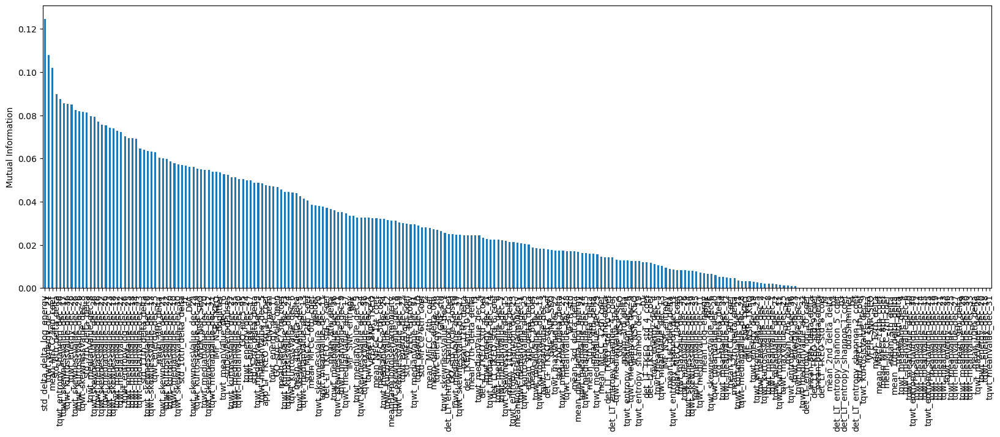

In [136]:
# 1) let's capture the above array in a pandas series
# 2)add the variable names in the index
# 3) sort the features based on their mutual information value
# 4) and make a var plot

mi = pd.Series(mi)
mi.index = X_train.columns
mi.sort_values(ascending=False).plot.bar(figsize=(20, 6))
plt.ylabel('Mutual Information')

# Perform univariate anova

In [137]:
# calculate the univariate statistical measure between
# each of the variables and the target

# similarly to chi2, the output is one array with f-scores
# and one array with the pvalues

univariate = f_classif(X_train, y_train)

univariate

(array([2.27476747e+01, 4.16609478e+00, 5.23251898e+01, 3.22827774e+01,
        3.78996498e+00, 1.67193472e+01, 7.15033955e+00, 3.88569927e+00,
        2.49558309e+01, 6.03065844e+01, 3.97436123e+01, 1.15415667e+00,
        3.56229209e-01, 3.40368959e-01, 1.27764872e+00, 1.13518747e+00,
        1.82595247e+00, 1.05804287e+01, 9.69791137e+00, 7.72742170e+00,
        1.42260444e+01, 1.43342313e+00, 1.80364125e+01, 1.80262525e+00,
        8.78227359e+00, 6.50695871e+00, 5.04306736e+01, 7.80390131e+00,
        3.03217357e+00, 1.32817831e+00, 3.54035148e+01, 1.49961601e-01,
        2.25648876e+01, 9.87530941e+00, 8.04692685e+00, 2.42517876e+01,
        2.11051706e+01, 2.83129459e+00, 1.04747558e+02, 2.73363809e+01,
        6.52477965e+00, 1.65671472e+01, 7.44558454e+00, 7.18476882e+00,
        4.99491824e+00, 7.26521862e+00, 3.73025697e-01, 2.43885405e+00,
        4.39989940e-01, 4.37979653e+00, 2.78867468e+00, 8.59134534e+00,
        8.99487318e-01, 1.62773255e+00, 6.34236794e-02, 3.022497

<AxesSubplot:>

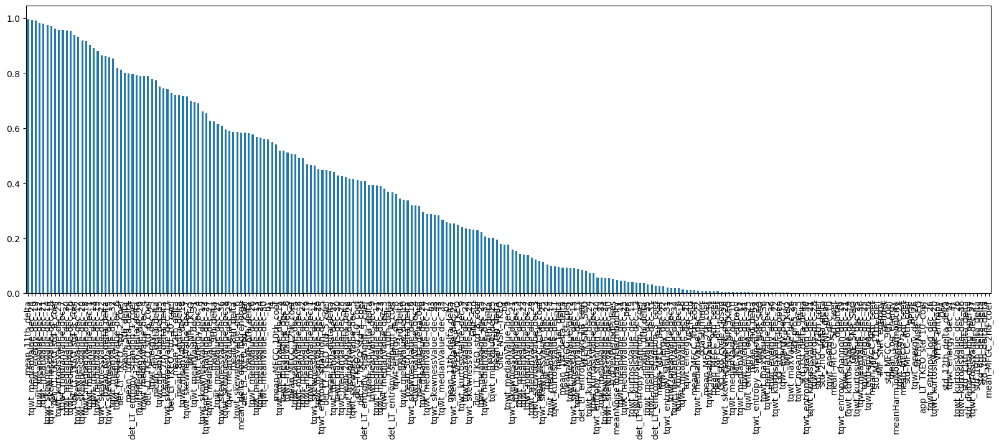

In [138]:
# 1) let's capture the pvalues in a pandas series
# 2) add the variable names in the index
# 3) sort the features based on their anova pvalues
# 4) and make a var plot

univariate = pd.Series(univariate[1])
univariate.index = X_train.columns
univariate.sort_values(ascending=False).plot.bar(figsize=(20, 6))

# Normalization

In [153]:
# Ajuste o escalador aos dados e normalize o conjunto de dados.
scaler = MinMaxScaler()

# Ajuste o escalador aos dados e normalize o DataFrame
normalized_data = pd.DataFrame(scaler.fit_transform(X_train), columns=X_train.columns)


In [154]:
normalized_data

,gender,PPE,DFA,RPDE,stdDevPeriodPulses,ddpJitter,ddaShimmer,meanNoiseToHarmHarmonicity,meanHarmToNoiseHarmonicity,f1,f2,f3,f4,b1,b2,b3,b4,GQ_prc5_95,GQ_std_cycle_open,GQ_std_cycle_closed,GNE_mean,GNE_std,GNE_SNR_SEO,GNE_NSR_TKEO,GNE_NSR_SEO,VFER_std,VFER_entropy,VFER_SNR_TKEO,VFER_SNR_SEO,VFER_NSR_TKEO,VFER_NSR_SEO,IMF_SNR_TKEO,IMF_SNR_entropy,IMF_NSR_TKEO,IMF_NSR_entropy,mean_Log_energy,mean_MFCC_0th_coef,mean_MFCC_1st_coef,mean_MFCC_2nd_coef,mean_MFCC_3rd_coef,mean_MFCC_4th_coef,mean_MFCC_5th_coef,mean_MFCC_6th_coef,mean_MFCC_7th_coef,mean_MFCC_8th_coef,mean_MFCC_9th_coef,mean_MFCC_10th_coef,mean_MFCC_11th_coef,mean_MFCC_12th_coef,mean_0th_delta,mean_1st_delta,mean_2nd_delta,mean_3rd_delta,mean_4th_delta,mean_5th_delta,mean_6th_delta,mean_7th_delta,mean_8th_delta,mean_9th_delta,mean_10th_delta,mean_11th_delta,mean_12th_delta,mean_delta_delta_log_energy,mean_delta_delta_0th,mean_1st_delta_delta,mean_2nd_delta_delta,mean_3rd_delta_delta,mean_4th_delta_delta,mean_5th_delta_delta,mean_6th_delta_delta,mean_7th_delta_delta,mean_8th_delta_delta,mean_9th_delta_delta,mean_10th_delta_delta,mean_11th_delta_delta,mean_12th_delta_delta,std_MFCC_6th_coef,std_MFCC_9th_coef,std_MFCC_11th_coef,std_MFCC_12th_coef,std_delta_delta_log_energy,std_1st_delta_delta,std_2nd_delta_delta,std_6th_delta_delta,std_7th_delta_delta,std_10th_delta_delta,std_11th_delta_delta,std_12th_delta_delta,det_TKEO_std_10_coef,det_LT_entropy_shannon_1_coef,det_LT_entropy_shannon_2_coef,det_LT_entropy_shannon_3_coef,det_LT_entropy_shannon_4_coef,det_LT_entropy_shannon_5_coef,det_LT_entropy_log_10_coef,det_LT_TKEO_std_2_coef,det_LT_TKEO_std_3_coef,det_LT_TKEO_std_4_coef,det_LT_TKEO_std_5_coef,det_LT_TKEO_std_6_coef,det_LT_TKEO_std_7_coef,det_LT_TKEO_std_8_coef,det_LT_TKEO_std_9_coef,det_LT_TKEO_std_10_coef,app_LT_TKEO_std_10_coef,tqwt_energy_dec_4,tqwt_energy_dec_10,tqwt_energy_dec_11,tqwt_energy_dec_17,tqwt_energy_dec_18,tqwt_energy_dec_19,tqwt_energy_dec_20,tqwt_energy_dec_21,tqwt_energy_dec_22,tqwt_energy_dec_23,tqwt_energy_dec_24,tqwt_energy_dec_25,tqwt_energy_dec_26,tqwt_energy_dec_27,tqwt_energy_dec_28,tqwt_energy_dec_31,tqwt_energy_dec_36,tqwt_entropy_shannon_dec_19,tqwt_entropy_shannon_dec_23,tqwt_entropy_shannon_dec_24,tqwt_entropy_shannon_dec_25,tqwt_entropy_shannon_dec_30,tqwt_entropy_shannon_dec_31,tqwt_entropy_shannon_dec_36,tqwt_entropy_log_dec_25,tqwt_entropy_log_dec_26,tqwt_entropy_log_dec_36,tqwt_medianValue_dec_1,tqwt_medianValue_dec_2,tqwt_medianValue_dec_3,tqwt_medianValue_dec_4,tqwt_medianValue_dec_5,tqwt_medianValue_dec_6,tqwt_medianValue_dec_7,tqwt_medianValue_dec_8,tqwt_medianValue_dec_9,tqwt_medianValue_dec_10,tqwt_medianValue_dec_11,tqwt_medianValue_dec_12,tqwt_medianValue_dec_13,tqwt_medianValue_dec_14,tqwt_medianValue_dec_15,tqwt_medianValue_dec_16,tqwt_medianValue_dec_17,tqwt_medianValue_dec_18,tqwt_medianValue_dec_19,tqwt_medianValue_dec_20,tqwt_medianValue_dec_21,tqwt_medianValue_dec_22,tqwt_medianValue_dec_23,tqwt_medianValue_dec_24,tqwt_medianValue_dec_25,tqwt_medianValue_dec_26,tqwt_medianValue_dec_27,tqwt_medianValue_dec_28,tqwt_medianValue_dec_29,tqwt_medianValue_dec_30,tqwt_medianValue_dec_31,tqwt_medianValue_dec_32,tqwt_medianValue_dec_33,tqwt_medianValue_dec_34,tqwt_medianValue_dec_35,tqwt_meanValue_dec_1,tqwt_meanValue_dec_2,tqwt_meanValue_dec_3,tqwt_meanValue_dec_4,tqwt_meanValue_dec_5,tqwt_meanValue_dec_6,tqwt_meanValue_dec_7,tqwt_meanValue_dec_8,tqwt_meanValue_dec_9,tqwt_meanValue_dec_10,tqwt_meanValue_dec_11,tqwt_meanValue_dec_12,tqwt_meanValue_dec_13,tqwt_meanValue_dec_14,tqwt_meanValue_dec_15,tqwt_meanValue_dec_16,tqwt_meanValue_dec_17,tqwt_meanValue_dec_18,tqwt_meanValue_dec_19,tqwt_meanValue_dec_20,tqwt_meanValue_dec_21,tqwt_meanValue_dec_22,tqwt_meanValue_dec_23,tqwt_meanValue_dec_24,tqwt_meanValue_dec_25,tqwt_meanValue_dec_26,tqwt_meanValue_dec_27,tqwt_meanValue_dec_28,tqwt_meanValue_dec_29,tqwt_meanValue_dec_30,tqwt_meanValue_dec_31,tqwt_meanValue_dec_32,tqwt_meanValue_dec_33,tqwt_meanValue_dec_34,tqwt_meanValue_dec_35,

In [150]:
X_train

,gender,PPE,DFA,RPDE,stdDevPeriodPulses,ddpJitter,ddaShimmer,meanNoiseToHarmHarmonicity,meanHarmToNoiseHarmonicity,f1,f2,f3,f4,b1,b2,b3,b4,GQ_prc5_95,GQ_std_cycle_open,GQ_std_cycle_closed,GNE_mean,GNE_std,GNE_SNR_SEO,GNE_NSR_TKEO,GNE_NSR_SEO,VFER_std,VFER_entropy,VFER_SNR_TKEO,VFER_SNR_SEO,VFER_NSR_TKEO,VFER_NSR_SEO,IMF_SNR_TKEO,IMF_SNR_entropy,IMF_NSR_TKEO,IMF_NSR_entropy,mean_Log_energy,mean_MFCC_0th_coef,mean_MFCC_1st_coef,mean_MFCC_2nd_coef,mean_MFCC_3rd_coef,mean_MFCC_4th_coef,mean_MFCC_5th_coef,mean_MFCC_6th_coef,mean_MFCC_7th_coef,mean_MFCC_8th_coef,mean_MFCC_9th_coef,mean_MFCC_10th_coef,mean_MFCC_11th_coef,mean_MFCC_12th_coef,mean_0th_delta,mean_1st_delta,mean_2nd_delta,mean_3rd_delta,mean_4th_delta,mean_5th_delta,mean_6th_delta,mean_7th_delta,mean_8th_delta,mean_9th_delta,mean_10th_delta,mean_11th_delta,mean_12th_delta,mean_delta_delta_log_energy,mean_delta_delta_0th,mean_1st_delta_delta,mean_2nd_delta_delta,mean_3rd_delta_delta,mean_4th_delta_delta,mean_5th_delta_delta,mean_6th_delta_delta,mean_7th_delta_delta,mean_8th_delta_delta,mean_9th_delta_delta,mean_10th_delta_delta,mean_11th_delta_delta,mean_12th_delta_delta,std_MFCC_6th_coef,std_MFCC_9th_coef,std_MFCC_11th_coef,std_MFCC_12th_coef,std_delta_delta_log_energy,std_1st_delta_delta,std_2nd_delta_delta,std_6th_delta_delta,std_7th_delta_delta,std_10th_delta_delta,std_11th_delta_delta,std_12th_delta_delta,det_TKEO_std_10_coef,det_LT_entropy_shannon_1_coef,det_LT_entropy_shannon_2_coef,det_LT_entropy_shannon_3_coef,det_LT_entropy_shannon_4_coef,det_LT_entropy_shannon_5_coef,det_LT_entropy_log_10_coef,det_LT_TKEO_std_2_coef,det_LT_TKEO_std_3_coef,det_LT_TKEO_std_4_coef,det_LT_TKEO_std_5_coef,det_LT_TKEO_std_6_coef,det_LT_TKEO_std_7_coef,det_LT_TKEO_std_8_coef,det_LT_TKEO_std_9_coef,det_LT_TKEO_std_10_coef,app_LT_TKEO_std_10_coef,tqwt_energy_dec_4,tqwt_energy_dec_10,tqwt_energy_dec_11,tqwt_energy_dec_17,tqwt_energy_dec_18,tqwt_energy_dec_19,tqwt_energy_dec_20,tqwt_energy_dec_21,tqwt_energy_dec_22,tqwt_energy_dec_23,tqwt_energy_dec_24,tqwt_energy_dec_25,tqwt_energy_dec_26,tqwt_energy_dec_27,tqwt_energy_dec_28,tqwt_energy_dec_31,tqwt_energy_dec_36,tqwt_entropy_shannon_dec_19,tqwt_entropy_shannon_dec_23,tqwt_entropy_shannon_dec_24,tqwt_entropy_shannon_dec_25,tqwt_entropy_shannon_dec_30,tqwt_entropy_shannon_dec_31,tqwt_entropy_shannon_dec_36,tqwt_entropy_log_dec_25,tqwt_entropy_log_dec_26,tqwt_entropy_log_dec_36,tqwt_medianValue_dec_1,tqwt_medianValue_dec_2,tqwt_medianValue_dec_3,tqwt_medianValue_dec_4,tqwt_medianValue_dec_5,tqwt_medianValue_dec_6,tqwt_medianValue_dec_7,tqwt_medianValue_dec_8,tqwt_medianValue_dec_9,tqwt_medianValue_dec_10,tqwt_medianValue_dec_11,tqwt_medianValue_dec_12,tqwt_medianValue_dec_13,tqwt_medianValue_dec_14,tqwt_medianValue_dec_15,tqwt_medianValue_dec_16,tqwt_medianValue_dec_17,tqwt_medianValue_dec_18,tqwt_medianValue_dec_19,tqwt_medianValue_dec_20,tqwt_medianValue_dec_21,tqwt_medianValue_dec_22,tqwt_medianValue_dec_23,tqwt_medianValue_dec_24,tqwt_medianValue_dec_25,tqwt_medianValue_dec_26,tqwt_medianValue_dec_27,tqwt_medianValue_dec_28,tqwt_medianValue_dec_29,tqwt_medianValue_dec_30,tqwt_medianValue_dec_31,tqwt_medianValue_dec_32,tqwt_medianValue_dec_33,tqwt_medianValue_dec_34,tqwt_medianValue_dec_35,tqwt_meanValue_dec_1,tqwt_meanValue_dec_2,tqwt_meanValue_dec_3,tqwt_meanValue_dec_4,tqwt_meanValue_dec_5,tqwt_meanValue_dec_6,tqwt_meanValue_dec_7,tqwt_meanValue_dec_8,tqwt_meanValue_dec_9,tqwt_meanValue_dec_10,tqwt_meanValue_dec_11,tqwt_meanValue_dec_12,tqwt_meanValue_dec_13,tqwt_meanValue_dec_14,tqwt_meanValue_dec_15,tqwt_meanValue_dec_16,tqwt_meanValue_dec_17,tqwt_meanValue_dec_18,tqwt_meanValue_dec_19,tqwt_meanValue_dec_20,tqwt_meanValue_dec_21,tqwt_meanValue_dec_22,tqwt_meanValue_dec_23,tqwt_meanValue_dec_24,tqwt_meanValue_dec_25,tqwt_meanValue_dec_26,tqwt_meanValue_dec_27,tqwt_meanValue_dec_28,tqwt_meanValue_dec_29,tqwt_meanValue_dec_30,tqwt_meanValue_dec_31,tqwt_meanValue_dec_32,tqwt_meanValue_dec_33,tqwt_meanValue_dec_34,tqwt_meanValue_dec_35,

# Determine univariate roc-auc

In [155]:
# determine roc-auc for each feature

# here we store the roc-auc values
roc_values = []

# iterate over each feature in the dataset
for feature in normalized_data.columns:

    # train a decision tree classifier
    clf = DecisionTreeClassifier(random_state=0)
    clf.fit(normalized_data[feature].fillna(0).to_frame(), y_train)

    # obtain the predictions
    y_scored = clf.predict_proba(X_test[feature].to_frame())

    # calculate and store the roc-auc
    roc_values.append(roc_auc_score(y_test, y_scored[:, 1]))
    
# display the result
roc_values[0:10]

[0.5776057791537668,
 0.4936016511867905,
 0.5376676986584107,
 0.5052115583075336,
 0.5176986584107327,
 0.5445304437564499,
 0.4795665634674922,
 0.47941176470588237,
 0.5,
 0.5]

Text(0, 0.5, 'roc-auc')

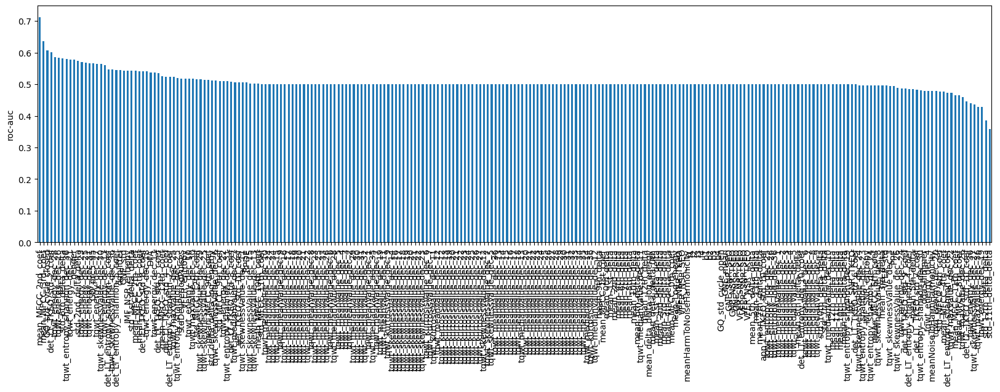

In [156]:
# now let's:

# 1) capture the roc-auc values in a pandas series
# 2) add the variable names in the index
# 3) sort the features based on the roc-auc
# 4) and make a var plot

roc_values = pd.Series(roc_values)
roc_values.index = normalized_data.columns
roc_values.sort_values(ascending=False).plot.bar(figsize=(20, 5))
plt.ylabel('roc-auc')

In [157]:
# a roc auc value of 0.5 indicates random decision
# let's check how many features show a roc-auc value
# higher than random

len(roc_values[roc_values > 0.5])

59

In [158]:
selected_features = roc_values[roc_values > 0.5].index

selected_features

Index(['gender', 'DFA', 'RPDE', 'stdDevPeriodPulses', 'ddpJitter',
       'GQ_prc5_95', 'GQ_std_cycle_closed', 'GNE_std', 'VFER_entropy',
       'IMF_NSR_entropy', 'mean_MFCC_2nd_coef', 'mean_MFCC_3rd_coef',
       'mean_MFCC_5th_coef', 'mean_MFCC_7th_coef', 'mean_MFCC_9th_coef',
       'mean_MFCC_10th_coef', 'mean_MFCC_12th_coef', 'std_MFCC_9th_coef',
       'std_MFCC_11th_coef', 'std_MFCC_12th_coef',
       'std_delta_delta_log_energy', 'std_1st_delta_delta',
       'std_2nd_delta_delta', 'std_6th_delta_delta', 'det_TKEO_std_10_coef',
       'det_LT_entropy_shannon_2_coef', 'det_LT_entropy_shannon_3_coef',
       'det_LT_entropy_shannon_5_coef', 'det_LT_TKEO_std_2_coef',
       'det_LT_TKEO_std_3_coef', 'det_LT_TKEO_std_4_coef',
       'det_LT_TKEO_std_5_coef', 'det_LT_TKEO_std_8_coef',
       'tqwt_energy_dec_10', 'tqwt_energy_dec_11', 'tqwt_energy_dec_17',
       'tqwt_energy_dec_18', 'tqwt_energy_dec_21', 'tqwt_energy_dec_22',
       'tqwt_energy_dec_23', 'tqwt_energy_dec_25', 'tq

In [159]:
# select features in the dataframes

X_train = X_train[selected_features]
X_test = X_test[selected_features]

X_train.shape, X_test.shape

((529, 59), (227, 59))

In [160]:
X_train.head()

,gender,DFA,RPDE,stdDevPeriodPulses,ddpJitter,GQ_prc5_95,GQ_std_cycle_closed,GNE_std,VFER_entropy,IMF_NSR_entropy,mean_MFCC_2nd_coef,mean_MFCC_3rd_coef,mean_MFCC_5th_coef,mean_MFCC_7th_coef,mean_MFCC_9th_coef,mean_MFCC_10th_coef,mean_MFCC_12th_coef,std_MFCC_9th_coef,std_MFCC_11th_coef,std_MFCC_12th_coef,std_delta_delta_log_energy,std_1st_delta_delta,std_2nd_delta_delta,std_6th_delta_delta,det_TKEO_std_10_coef,det_LT_entropy_shannon_2_coef,det_LT_entropy_shannon_3_coef,det_LT_entropy_shannon_5_coef,det_LT_TKEO_std_2_coef,det_LT_TKEO_std_3_coef,det_LT_TKEO_std_4_coef,det_LT_TKEO_std_5_coef,det_LT_TKEO_std_8_coef,tqwt_energy_dec_10,tqwt_energy_dec_11,tqwt_energy_dec_17,tqwt_energy_dec_18,tqwt_energy_dec_21,tqwt_energy_dec_22,tqwt_energy_dec_23,tqwt_energy_dec_25,tqwt_energy_dec_26,tqwt_energy_dec_27,tqwt_energy_dec_28,tqwt_energy_dec_31,tqwt_entropy_shannon_dec_25,tqwt_entropy_shannon_dec_31,tqwt_entropy_shannon_dec_36,tqwt_medianValue_dec_27,tqwt_maxValue_dec_25,tqwt_maxValue_dec_30,tqwt_skewnessValue_dec_6,tqwt_skewnessValue_dec_11,tqwt_skewnessValue_dec_13,tqwt_skewnessValue_dec_15,tqwt_skewnessValue_dec_25,tqwt_skewnessValue_dec_29,tqwt_skewnessValue_dec_30,tqwt_skewnessValue_dec_36
580,0,0.71933,0.55591,0.001947,0.00190,0.80240,18.9267,0.13005,1.48310,0.22098,3.206800,-1.64420,-1.164900,0.374020,-0.19242,-1.26450,-0.614300,0.26660,0.19987,0.18158,0.011510,0.029449,0.021294,0.018010,1332.6517,0.955240,1.379500,0.187390,0.020247,0.019887,0.234040,0.504010,0.451250,0.001074,0.000336,0.084549,0.133760,0.116200,0.082100,0.007478,0.080937,0.039540,0.000828,0.000043,0.000015,391.7822,0.51622,0.63924,0.000745,0.72668,0.046147,-1.297300,-0.013973,-4.190000e-18,-0.002130,2.180000e-18,-0.140730,-2.410000e-16,-6.468800
691,0,0.72914,0.28905,0.000059,0.00027,1.00000,0.0000,0.19541,7.66230,0.24175,1.468000,-2.42260,-0.970070,-0.949540,-0.81902,-0.19031,-0.701770,0.23637,0.21688,0.21332,0.008866,0.023523,0.019791,0.019412,1856.9017,0.005552,0.009118,0.057200,0.000015,0.000030,0.001604,0.000667,0.003967,0.001953,0.003067,0.087289,0.099606,0.025498,0.042195,0.163610,0.015842,0.000216,0.000110,0.000069,0.000067,25.7789,0.18901,0.61548,0.000058,0.21538,0.046353,0.115580,0.005863,-1.400000e-17,-0.000197,-1.480000e-17,2.808900,-2.580000e-16,8.193200
315,1,0.68074,0.55504,0.000139,0.00090,1.00000,0.0000,0.12054,1.00600,0.15288,0.033064,0.56313,-1.658800,-0.058185,0.30649,-1.33480,0.482350,0.56355,0.32532,0.30060,0.016976,0.038070,0.040454,0.025781,26101.7366,1.089500,0.183960,0.180800,0.101940,0.002740,0.067036,0.003463,0.386390,0.001379,0.001413,0.189070,0.186840,0.056944,0.034566,0.008145,0.104490,0.043022,0.000740,0.000062,0.000034,351.0093,0.75304,3.28500,0.000998,0.98762,0.105370,-0.013342,-0.012098,3.950000e-05,-0.004667,3.132400e-04,-0.906850,-1.880100e-01,0.078214
200,0,0.80090,0.43934,0.000076,0.00081,1.00000,0.0000,0.30526,1.12070,0.26883,4.400100,2.20700,-0.043326,-0.080918,-0.90468,-1.07380,-1.266000,0.22886,0.31413,0.19412,0.012484,0.041536,0.023898,0.017676,408.5042,0.005893,0.045280,0.049737,0.000010,0.000216,0.002500,0.000621,0.018797,0.000016,0.000033,0.008157,0.007018,0.219370,0.133310,0.021298,0.275830,0.109440,0.001595,0.000203,0.000092,-1319.7122,2.22660,9.47120,-0.000912,2.32060,0.425990,-1.013500,-2.607500,1.374300e-02,-0.027141,2.488600e-04,4.986800,7.557800e-01,1.058300
319,1,0.72515,0.71831,0.000379,0.00248,0.79689,7.3300,0.13296,0.20366,0.18589,3.416000,0.18163,-0.374410,-0.306290,0.26696,0.83178,-0.006118,0.32010,0.24189,0.22119,0.011601,0.018293,0.017251,0.025626,2796.0690,0.004249,0.018301,0.235800,0.000008,0.000063,0.001669,0.002285,0.030152,0.000713,0.000446,0.074369,0.146310,0.035963,0.033758,0.035693,0.073159,0.026408,0.025649,0.112840,0.000257,92.1048,0.61693,0.57223,-0.000187,0.33633,0.221830,0.664770,0.150240,8.030000e-17,0.114200,4.480000e-18,-0.001399,2.020000e-17,-0.774580


# Recursive Feature Elimination

In [41]:
# the ML model for which we want to select features

model = GradientBoostingClassifier(
    n_estimators=10,
    max_depth=2,
    random_state=10,
)

In [48]:
# Setup the RFE selector

sel = RecursiveFeatureElimination(
    variables=None, # automatically evaluate all numerical variables
    estimator = model, # the ML model
    scoring = 'roc_auc', # the metric we want to evalute
    threshold = 0.0005, # the maximum performance drop allowed to remove a feature
    cv=2, # cross-validation
)

# this may take quite a while, because
# we are building a lot of models with cross-validation
sel.fit(X_train, y_train)

RecursiveFeatureElimination(cv=2,
                            estimator=GradientBoostingClassifier(max_depth=2,
                                                                 n_estimators=10,
                                                                 random_state=10),
                            threshold=0.0005)

In [49]:
# performance of model trained using all features

sel.initial_model_performance_

0.8565558108234581

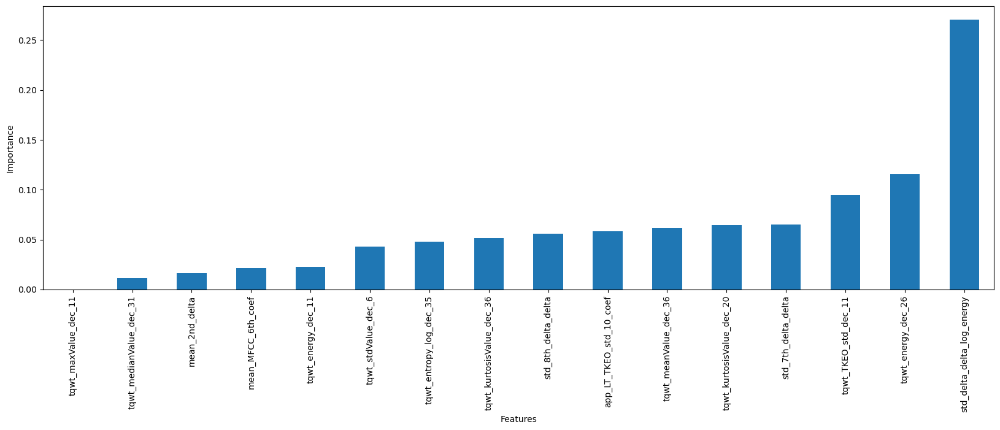

In [50]:
# importance of all features based of initial model

sel.feature_importances_.plot.bar(figsize=(20,6))
plt.xlabel('Features')
plt.ylabel('Importance')
plt.show()

In [51]:
# Number of features that will be removed

len(sel.features_to_drop_)

6

In [52]:
# select features

X_train = sel.transform(X_train)
X_test = sel.transform(X_test)

X_train.shape, X_test.shape

((529, 10), (227, 10))

In [53]:
# now for comparison
# fit the model with the selected features
model.fit(X_train, y_train)

# make predictions
y_pred_test = model.predict_proba(X_test)[:, 1]

# calculate roc-auc
roc_final = roc_auc_score(y_test, y_pred_test)
print('Test selected features ROC AUC=%f' % (roc_final))

Test selected features ROC AUC=0.849381


In [54]:
X_train

,mean_MFCC_6th_coef,mean_2nd_delta,std_delta_delta_log_energy,std_7th_delta_delta,std_8th_delta_delta,tqwt_energy_dec_26,tqwt_entropy_log_dec_35,tqwt_TKEO_std_dec_11,tqwt_medianValue_dec_31,tqwt_kurtosisValue_dec_20
580,-1.282900,5.408200e-03,0.011510,0.010647,0.014220,3.954000e-02,-3114.0229,6.858800e-04,4.060700e-04,2.1910
691,-1.305200,-1.735200e-03,0.008866,0.018273,0.013873,2.156600e-04,-3296.4725,9.080000e-05,6.470000e-06,1.8855
315,0.014682,1.600300e-02,0.016976,0.020238,0.017469,4.302200e-02,-2266.4329,4.733400e-04,3.367000e-04,2.8823
200,0.670460,-5.216900e-04,0.012484,0.019165,0.020988,1.094400e-01,-2084.4568,3.241000e-04,1.312800e-04,1.9759
319,-1.687500,3.436700e-03,0.011601,0.017972,0.017085,2.640800e-02,-2906.0605,2.480000e-05,1.595700e-03,4.1546
753,-0.467610,5.631500e-03,0.006292,0.016366,0.013659,8.999400e-03,-2022.5234,2.497800e-03,6.707600e-04,1.9942
463,0.155860,4.111800e-03,0.008955,0.017299,0.020105,2.133100e-02,-2069.4712,1.930600e-04,1.109900e-03,3.5594
12,-1.197700,1.517500e-03,0.026047,0.019221,0.016488,8.939000e-04,-3595.3165,6.830000e-06,4.890000e-05,2.5705
161,-1.499300,-1.991300e-04,0.010297,0.018259,0.015992,2.304300e-01,-3030.3581,1.110000e-05,2.120300e-04,2.5873
247,-0.328790,1.759100e-03,0.021429,0.025296,0.022914,1.719900e-02,-4239.4575,7.120000e-08,8.330000e-05,3.3003
